In [1]:
import os
import librosa
import numpy as np

# Directorio raíz donde están las carpetas nombradas según las etiquetas
root_dir = './Datasets/Kaggle-Speech-Comand/Speech_Cmd/dataset/'

# Diccionario para almacenar los datos
data = []

# Recorrer cada carpeta y archivo, asignar etiqueta y convertir a vector
for label in sorted(os.listdir(root_dir)):
    # La carpeta actual es la etiqueta
    label_dir = os.path.join(root_dir, label)
    
    if os.path.isdir(label_dir):
        for file_name in os.listdir(label_dir):
            file_path = os.path.join(label_dir, file_name)
            if file_name.endswith('.wav'):
                # Cargar el archivo de audio como vector
                vector, sr = librosa.load(file_path, sr=None)
                # Almacenar vector y etiqueta
                data.append((vector, label))

# Si necesitas los datos como arrays de NumPy
vectors, labels = zip(*data)  # Desempaqueta en dos listas separadas

print(labels)





('bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird',

In [2]:
import pickle

# Serializar y guardar los datos
with open('vectors_labels.pickle', 'wb') as archivo:
    pickle.dump((vectors, labels), archivo)


In [3]:
with open('vectors_labels.pickle', 'rb') as archivo:
    vectors, labels = pickle.load(archivo)


In [4]:
import numpy as np
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split

# Convertir etiquetas a índices numéricos
le = LabelEncoder()
numeric_labels = le.fit_transform(labels)

# One-hot encoding de las etiquetas
one_hot_labels = to_categorical(numeric_labels)

In [38]:

print(one_hot_labels)

[[1. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 1.]
 [0. 0. 0. ... 0. 0. 1.]
 [0. 0. 0. ... 0. 0. 1.]]


In [164]:
# preprocesing data

def dividir_y_graficar_senal(t, onda_total, num_particiones,plot=False):
    # Calcular la longitud de cada partición
    index_tau = int(len(t) / num_particiones)
    
    # Lista para guardar los segmentos de la señal
    segmentos = []
    
    
    if plot:
        # Crear figura y ejes para graficar cada segmento por separado
        fig, axs = plt.subplots(num_particiones + 1, 1, figsize=(12, 3 * num_particiones))
        
    for i in range(num_particiones):
        # Calcular los índices para esta partición
        start_idx = i * index_tau
        end_idx = (i + 1) * index_tau if (i < num_particiones - 1) else len(t)
            
        # Dividir la señal y el vector de tiempo para esta partición
        t_part = t[start_idx:end_idx]
        onda_total_part = onda_total[start_idx:end_idx]
            
        # Añadir a la lista de segmentos
        segmentos.append((t_part, onda_total_part))
        if plot:    
            # Graficar esta partición
            axs[i].plot(t_part, onda_total_part)
            axs[i].set_title(f'Segmento {i + 1}')
            axs[i].set_xlabel('Tiempo [s]')
            axs[i].set_ylabel('Amplitud')
            axs[i].set_xlim(0, 1)
            axs[i].set_ylim(min(onda_total), max(onda_total))

    if plot:
        # Graficar onda total
        axs[-1].plot(t, onda_total)
        axs[-1].set_title('Sumatoria de ondas')
        axs[-1].set_xlabel('Tiempo [s]')
        axs[-1].set_ylabel('Amplitud')
        # Ajustar el espacio entre los gráficos
        fig.tight_layout(pad=3.0)
        plt.show()
    
    return segmentos



import numpy as np
import matplotlib.pyplot as plt

def graficar_segmentos_y_fft(segmentos, dt):
    num_segmentos = len(segmentos)
    fig, axs = plt.subplots(num_segmentos, 2, figsize=(15, 4 * num_segmentos))

    # Si solo hay un segmento, axs se convierte en un array bidimensional
    if num_segmentos == 1:
        axs = [axs]

    for i, (t_segment, onda_segment) in enumerate(segmentos):
        ax_signal = axs[i][0]
        ax_fft = axs[i][1]
        
        # Graficar el segmento
        ax_signal.plot(t_segment, onda_segment)
        ax_signal.set_title(f'Segmento {i + 1}')
        ax_signal.set_xlabel('Tiempo [s]')
        ax_signal.set_ylabel('Amplitud')
        ax_signal.set_xlim(t_segment[0], t_segment[-1])
        ax_signal.grid(True)
        
        # Calcular FFT con ventana y ajustes anteriores
        window_segment = np.hanning(len(onda_segment))
        onda_windowed_segment = onda_segment * window_segment
        transformada_windowed_segment = np.fft.fft(onda_windowed_segment, n=2*len(onda_segment))
        frecuencias_windowed_segment = np.fft.fftfreq(transformada_windowed_segment.shape[-1], d=dt)
        
        # Seleccionar y mostrar solo las frecuencias positivas
        indices_positivos_segment = frecuencias_windowed_segment > 0
        frecuencias_positivas_segment = frecuencias_windowed_segment[indices_positivos_segment]
        transformada_positiva_segment = transformada_windowed_segment[indices_positivos_segment]
        
        # Graficar Transformada de Fourier del segmento
        ax_fft.plot(frecuencias_positivas_segment, np.abs(transformada_positiva_segment))
        ax_fft.set_title(f'Transformada de Fourier del Segmento {i + 1}')
        ax_fft.set_xlabel('Frecuencia [Hz]')
        ax_fft.set_ylabel('Amplitud')
        ax_fft.grid(True)
        
    fig.tight_layout(pad=3.0)
    plt.show()



# Función para calcular la FFT de un segmento
def calcular_fft_segmento(onda_segment, dt):
    window_segment = np.hanning(len(onda_segment))
    onda_windowed_segment = onda_segment * window_segment
    transformada_windowed_segment = np.fft.fft(onda_windowed_segment, n=2*len(onda_segment))
    frecuencias_windowed_segment = np.fft.fftfreq(transformada_windowed_segment.shape[-1], d=dt)
    indices_positivos = frecuencias_windowed_segment > 0
    frecuencias_positivas = frecuencias_windowed_segment[indices_positivos]
    transformada_positiva = transformada_windowed_segment[indices_positivos]
    return frecuencias_positivas, transformada_positiva


# Función para obtener las amplitudes promedio de cada canal
def obtener_amplitudes_canales(frecuencias, transformada, num_canales, f_max_adjustable):
    ancho_canal = f_max_adjustable / num_canales
    amplitudes_canales = []
    for i in range(num_canales):
        lim_inf = i * ancho_canal
        lim_sup = (i + 1) * ancho_canal
        amplitudes_en_canal = transformada[(frecuencias >= lim_inf) & (frecuencias < lim_sup)]
        amplitud_promedio = np.mean(np.abs(amplitudes_en_canal))
        amplitudes_canales.append(amplitud_promedio)
    return amplitudes_canales



# Función general que procesa los segmentos y devuelve un array de amplitudes por canal
def procesar_segmentos(segmentos, dt, num_canales, f_max_adjustable):
    amplitudes_por_segmento = []
    for segment in segmentos:
        frecuencias, transformada = calcular_fft_segmento(segment[1], dt)
        amplitudes = obtener_amplitudes_canales(frecuencias, transformada, num_canales, f_max_adjustable)
        amplitudes_por_segmento.append(amplitudes)
    
    # Convertir la lista de listas a un array de NumPy
    amplitudes_array = np.array(amplitudes_por_segmento)

    ancho_canal = f_max_adjustable / num_canales
    for idx, amplitudes in enumerate(amplitudes_array, 1):
        print(f"\nAmplitudes para el Segmento {idx}:")
        for i, amp in enumerate(amplitudes, 1):
            lim_inf = (i - 1) * ancho_canal
            lim_sup = i * ancho_canal
            print(f" - Canal {i} ({lim_inf:.2f}-{lim_sup:.2f} Hz): {amp:.2f}")

    return amplitudes_array



# Esta función ahora encapsula todo el proceso, desde calcular la FFT por segmento hasta imprimir los resultados
def analizar_segmentos(segmentos, dt, num_canales, f_max_adjustable , plot=False):
    
    ancho_canal = f_max_adjustable / num_canales
    resultados_amplitudes = []  # Para almacenar las amplitudes promedio de todos los segmentos

    def calcular_fft_segmento(onda_segment):
        window_segment = np.hanning(len(onda_segment))
        onda_windowed_segment = onda_segment * window_segment
        
        transformada_windowed_segment = np.fft.fft(onda_windowed_segment, n=2*len(onda_segment))
        frecuencias_windowed_segment = np.fft.fftfreq(transformada_windowed_segment.shape[-1], d=dt)
        
        # Filtrar las frecuencias y amplitudes positivas
        indices_positivos = frecuencias_windowed_segment > 0
        frecuencias_positivas = frecuencias_windowed_segment[indices_positivos]
        transformada_positiva = transformada_windowed_segment[indices_positivos]
        return frecuencias_positivas, transformada_positiva

    def ifft_canal(frecuencias, transformada, lim_inf, lim_sup):
        transformada_en_canal = np.copy(transformada)
        transformada_en_canal[(frecuencias < lim_inf) | (frecuencias >= lim_sup)] = 0
        onda_inversa = np.fft.ifft(transformada_en_canal)
        return onda_inversa.real

    def amplitud_promedio_ifft(onda_inversa):
        return np.mean(np.abs(onda_inversa))

    def plot_segmento(frecuencias, transformada, ondas_inversas, segmento_num):
        fig, axs = plt.subplots(num_canales, 2, figsize=(15, 12))
        for i in range(num_canales):
            lim_inf = i * ancho_canal
            lim_sup = (i + 1) * ancho_canal
            # Graficar espacio de Fourier
            axs[i, 0].plot(frecuencias[(frecuencias >= lim_inf) & (frecuencias < lim_sup)], 
                        np.abs(transformada[(frecuencias >= lim_inf) & (frecuencias < lim_sup)]))
            axs[i, 0].set_title(f'Segmento {segmento_num} - Canal {i+1} en Espacio de Fourier')
            axs[i, 0].set_xlabel('Frecuencia [Hz]')
            axs[i, 0].set_ylabel('Amplitud')
            axs[i, 0].grid(True)
            # Graficar transformada inversa
            axs[i, 1].plot(ondas_inversas[i].real, color='green')
            axs[i, 1].set_title(f'Segmento {segmento_num} - Canal {i+1} Transformada Inversa')
            axs[i, 1].set_xlabel('Tiempo [puntos]')
            axs[i, 1].set_ylabel('Amplitud')
            axs[i, 1].grid(True)
        plt.tight_layout()
        plt.show()


    # Procesar cada segmento
    for idx, (t_segmento, onda_segment) in enumerate(segmentos, 1):
        frecuencias, fft = calcular_fft_segmento(onda_segment)
        ondas_inversas = []
        amplitudes_promedio = []
        
        for j in range(num_canales):
            lim_inf = j * ancho_canal
            lim_sup = (j + 1) * ancho_canal
            onda_inversa_canal = ifft_canal(frecuencias, fft, lim_inf, lim_sup)
            ondas_inversas.append(onda_inversa_canal)
            amplitud_prom = amplitud_promedio_ifft(onda_inversa_canal)
            amplitudes_promedio.append(amplitud_prom)
        
        resultados_amplitudes.append(amplitudes_promedio)
        if plot:
            plot_segmento(frecuencias, fft, ondas_inversas, idx)
    
    resultados_amplitudes = np.array(resultados_amplitudes)
    
    # Imprimir resultados
    def imprimir_amplitudes(resultados_amplitudes):
        for idx, amplitudes in enumerate(resultados_amplitudes, 1):
            print(f"\nAmplitudes para el Segmento {idx}:")
            for i, amp in enumerate(amplitudes, 1):
                lim_inf = (i - 1) * ancho_canal
                lim_sup = i * ancho_canal
                print(f" - Canal {i} ({lim_inf}-{lim_sup} Hz): {amp:.6f}")

    imprimir_amplitudes(resultados_amplitudes)
    
    return resultados_amplitudes


def preprocesar_audio(t,onda_total,num_particiones,num_canales,f_max_adjustable,dt):
    segmentos = dividir_y_graficar_senal(t, onda_total, num_particiones,plot=False)
    audio_procesado = procesar_segmentos(segmentos, dt, num_canales, f_max_adjustable)
    return audio_procesado



In [35]:
vectors_mini_dataset = vectors[0:5]

print(vectors_mini_dataset)


#dog = './Datasets/Kaggle-Speech-Comand/Speech_Cmd/dataset/dog/00b01445_nohash_0.wav'
# Carga los archivos de audio
#dog, sr_dog = librosa.load(dog, sr=None)  # Carga con la frecuencia de muestreo original
#t = np.linspace(0, len(dog) / sr_dog, num=len(dog))
#dt = 1/sr_dog 

#segmentos = dividir_y_graficar_senal(t=t, onda_total = vectors_mini_dataset, num_particiones=2,plot=True)
#result = analizar_segmentos(segmentos, dt, num_canales=5, f_max_adjustable=8000 , plot=False)

#print(result) 


(array([-0.00750732,  0.04653931,  0.02041626, ..., -0.01004028,
       -0.01300049, -0.00250244], dtype=float32), array([-1.5258789e-04, -2.1362305e-04, -3.6621094e-04, ...,
        1.2207031e-04,  6.1035156e-05,  3.9672852e-04], dtype=float32), array([-6.1035156e-05,  6.1035156e-05,  9.1552734e-05, ...,
       -2.7465820e-04, -2.1362305e-04, -1.8310547e-04], dtype=float32), array([-1.2207031e-04, -4.8828125e-04, -3.3569336e-04, ...,
        3.0517578e-05,  6.1035156e-05,  3.3569336e-04], dtype=float32), array([-0.00152588, -0.00149536, -0.0017395 , ..., -0.00177002,
       -0.00149536, -0.00183105], dtype=float32))


In [165]:
def seleccionar_datos_por_label(vectors, labels, num_datos_por_label):
    # Crear un diccionario para agrupar los vectores por etiqueta
    data_por_label = {}
    for vector, label in zip(vectors, labels):
        if label not in data_por_label:
            data_por_label[label] = []
        data_por_label[label].append(vector)

    # Seleccionar num_datos_por_label elementos de cada etiqueta
    datos_seleccionados = []
    for label, vectores in data_por_label.items():
        vectores_seleccionados = vectores[:num_datos_por_label]  # Selecciona los primeros num_datos_por_label vectores
        for vector in vectores_seleccionados:
            datos_seleccionados.append((vector, label))

    return datos_seleccionados

# Uso de la función
num_datos_por_label = 40  # Número de datos que deseas seleccionar por etiqueta
dataset_seleccionado = seleccionar_datos_por_label(vectors, labels, num_datos_por_label)

# Visualizar algunos elementos del dataset resultante
for i in range(10):
    print(f"Vector: {dataset_seleccionado[i][0][:3]} - Label: {dataset_seleccionado[i][1]}")  # Muestra los primeros 10 elementos del vector


print(dataset_seleccionado)

Vector: [-0.00750732  0.04653931  0.02041626] - Label: bird
Vector: [-0.00015259 -0.00021362 -0.00036621] - Label: bird
Vector: [-6.1035156e-05  6.1035156e-05  9.1552734e-05] - Label: bird
Vector: [-0.00012207 -0.00048828 -0.00033569] - Label: bird
Vector: [-0.00152588 -0.00149536 -0.0017395 ] - Label: bird
Vector: [0.00357056 0.006073   0.00546265] - Label: bird
Vector: [6.1035156e-05 0.0000000e+00 0.0000000e+00] - Label: bird
Vector: [0.00015259 0.00018311 0.00015259] - Label: bird
Vector: [ 0.0000000e+00  0.0000000e+00 -3.0517578e-05] - Label: bird
Vector: [0.0057373  0.01025391 0.01080322] - Label: bird
[(array([-0.00750732,  0.04653931,  0.02041626, ..., -0.01004028,
       -0.01300049, -0.00250244], dtype=float32), 'bird'), (array([-1.5258789e-04, -2.1362305e-04, -3.6621094e-04, ...,
        1.2207031e-04,  6.1035156e-05,  3.9672852e-04], dtype=float32), 'bird'), (array([-6.1035156e-05,  6.1035156e-05,  9.1552734e-05, ...,
       -2.7465820e-04, -2.1362305e-04, -1.8310547e-04], d

In [166]:

dog = './Datasets/Kaggle-Speech-Comand/Speech_Cmd/dataset/dog/00b01445_nohash_0.wav'
# Carga los archivos de audio
dog, sr = librosa.load(dog, sr=None)  # Carga con la frecuencia de muestreo original



# Lista para almacenar los resultados del procesamiento de cada audio junto con su etiqueta
resultados_procesados = []

# Iterar sobre cada vector de audio y su etiqueta
for vector, label in dataset_seleccionado:
    # Calcular 't' y 'dt' específicos para cada vector de audio
    sr = librosa.get_samplerate(file_path) # Asumir o calcular la tasa de muestreo para cada audio
    dt = 1 / sr
    t = np.linspace(0, len(vector) / sr, num=len(vector))
    
    try:
        # Procesar el audio
        audio_procesado = preprocesar_audio(onda_total=vector, t=t, num_particiones=10, num_canales=73, f_max_adjustable=8000, dt=dt)
        # Añadir el audio procesado y su etiqueta a los resultados
        resultados_procesados.append((audio_procesado, label))
    except ValueError as e:
        print(f"Error al procesar el audio con la etiqueta {label}: {e}")

# Ahora, resultados_procesados contiene los audios procesados junto con sus etiquetas

#print(resultados_procesados)



    


Amplitudes para el Segmento 1:
 - Canal 1 (0.00-109.59 Hz): 0.00
 - Canal 2 (109.59-219.18 Hz): 0.05
 - Canal 3 (219.18-328.77 Hz): 0.12
 - Canal 4 (328.77-438.36 Hz): 0.12
 - Canal 5 (438.36-547.95 Hz): 0.08
 - Canal 6 (547.95-657.53 Hz): 0.38
 - Canal 7 (657.53-767.12 Hz): 0.27
 - Canal 8 (767.12-876.71 Hz): 0.23
 - Canal 9 (876.71-986.30 Hz): 0.18
 - Canal 10 (986.30-1095.89 Hz): 0.53
 - Canal 11 (1095.89-1205.48 Hz): 0.45
 - Canal 12 (1205.48-1315.07 Hz): 0.46
 - Canal 13 (1315.07-1424.66 Hz): 0.51
 - Canal 14 (1424.66-1534.25 Hz): 0.36
 - Canal 15 (1534.25-1643.84 Hz): 0.51
 - Canal 16 (1643.84-1753.42 Hz): 0.55
 - Canal 17 (1753.42-1863.01 Hz): 0.46
 - Canal 18 (1863.01-1972.60 Hz): 0.71
 - Canal 19 (1972.60-2082.19 Hz): 0.46
 - Canal 20 (2082.19-2191.78 Hz): 0.48
 - Canal 21 (2191.78-2301.37 Hz): 0.26
 - Canal 22 (2301.37-2410.96 Hz): 0.40
 - Canal 23 (2410.96-2520.55 Hz): 0.27
 - Canal 24 (2520.55-2630.14 Hz): 0.38
 - Canal 25 (2630.14-2739.73 Hz): 0.67
 - Canal 26 (2739.73-28

In [182]:
import pickle

# Serializar y guardar los datos
with open('dataFiltered.pickle', 'wb') as archivo:
    pickle.dump(resultados_procesados, archivo)

In [168]:
# Imprimir los primeros 5 elementos de resultados_procesados para evaluar la estructura
for i, (audio_procesado, etiqueta) in enumerate(resultados_procesados):
    print(f"Elemento {i}:")
    print(f" - Etiqueta: {etiqueta}")
    print(f" - Cantidad de Segmentos: {len(audio_procesado)}")


    if i >= 4:  # Limitar a los primeros 5 elementos
        break


Elemento 0:
 - Etiqueta: bird
 - Cantidad de Segmentos: 10
Elemento 1:
 - Etiqueta: bird
 - Cantidad de Segmentos: 10
Elemento 2:
 - Etiqueta: bird
 - Cantidad de Segmentos: 10
Elemento 3:
 - Etiqueta: bird
 - Cantidad de Segmentos: 10
Elemento 4:
 - Etiqueta: bird
 - Cantidad de Segmentos: 10


In [169]:
from sklearn.model_selection import train_test_split

# Separar los audios procesados y las etiquetas en dos listas separadas
audios_procesados = [elemento[0] for elemento in resultados_procesados]
etiquetas = [elemento[1] for elemento in resultados_procesados]

from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()
etiquetas_encoded = label_encoder.fit_transform(etiquetas)



from tensorflow.keras.utils import to_categorical

etiquetas_one_hot = to_categorical(etiquetas_encoded)



# Dividir los datos en conjuntos de entrenamiento y prueba con estratificación
X_train, X_test, y_train, y_test = train_test_split(
    audios_procesados, etiquetas_one_hot, test_size=0.2, random_state=42, shuffle=True, stratify=etiquetas_encoded
)


# Ahora X_train y X_test contienen los audios procesados para entrenamiento y prueba,
# mientras que y_train y y_test contienen las etiquetas correspondientes.

print(etiquetas_one_hot)


[[1. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 1.]
 [0. 0. 0. ... 0. 0. 1.]
 [0. 0. 0. ... 0. 0. 1.]]


Distribución de clases en el conjunto de entrenamiento: {0: 32, 1: 32, 2: 32, 3: 32, 4: 32, 5: 32, 6: 32, 7: 32, 8: 32, 9: 32, 10: 32, 11: 32, 12: 32, 13: 32}
Distribución de clases en el conjunto de prueba: {0: 8, 1: 8, 2: 8, 3: 8, 4: 8, 5: 8, 6: 8, 7: 8, 8: 8, 9: 8, 10: 8, 11: 8, 12: 8, 13: 8}


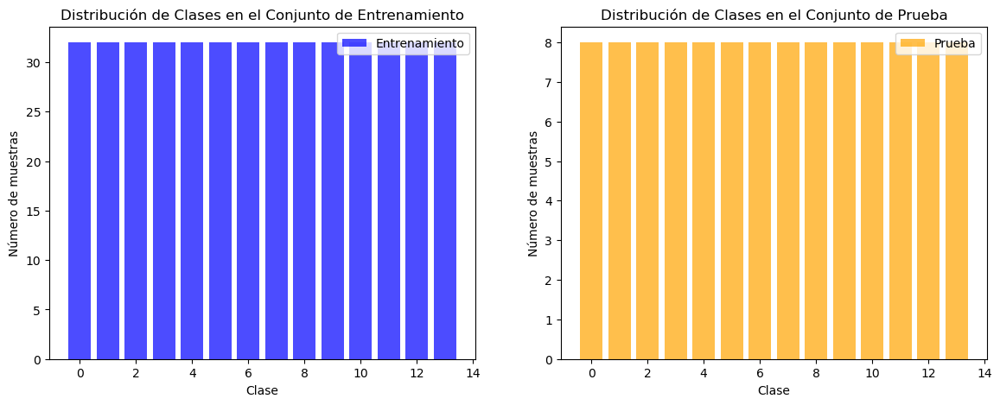

In [170]:
import numpy as np

X_train = np.array(X_train)
X_test = np.array(X_test)
y_train = np.array(y_train)
y_test = np.array(y_test)


import numpy as np

# Suponiendo que y_train y y_test son arrays de one-hot encoding
# Convertir de one-hot encoding a etiquetas numéricas para contar las ocurrencias
y_train_labels = np.argmax(y_train, axis=1)
y_test_labels = np.argmax(y_test, axis=1)

# Contar las ocurrencias de cada clase en el conjunto de entrenamiento
unique, counts_train = np.unique(y_train_labels, return_counts=True)
train_distribution = dict(zip(unique, counts_train))

# Contar las ocurrencias de cada clase en el conjunto de prueba
unique, counts_test = np.unique(y_test_labels, return_counts=True)
test_distribution = dict(zip(unique, counts_test))

# Imprimir la distribución de clases en los conjuntos de entrenamiento y prueba
print("Distribución de clases en el conjunto de entrenamiento:", train_distribution)
print("Distribución de clases en el conjunto de prueba:", test_distribution)

# También puedes querer visualizar la distribución de clases
import matplotlib.pyplot as plt

plt.figure(figsize=(14, 5))

plt.subplot(1, 2, 1)
plt.bar(train_distribution.keys(), train_distribution.values(), color='blue', alpha=0.7, label='Entrenamiento')
plt.xlabel('Clase')
plt.ylabel('Número de muestras')
plt.title('Distribución de Clases en el Conjunto de Entrenamiento')
plt.legend()

plt.subplot(1, 2, 2)
plt.bar(test_distribution.keys(), test_distribution.values(), color='orange', alpha=0.7, label='Prueba')
plt.xlabel('Clase')
plt.ylabel('Número de muestras')
plt.title('Distribución de Clases en el Conjunto de Prueba')
plt.legend()

plt.show()




In [171]:
print("Forma de X_train:", X_train.shape)
print("Forma de X_test:", X_test.shape)
print("Forma de y_train:", y_train.shape)
print("Forma de y_test:", y_test.shape)


Forma de X_train: (448, 10, 73)
Forma de X_test: (112, 10, 73)
Forma de y_train: (448, 14)
Forma de y_test: (112, 14)


## MODEL 1 SIMPLE RNN

In [172]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import SimpleRNN, Dense, LSTM , Flatten

model = Sequential([

    SimpleRNN(64, input_shape=(X_train.shape[1], X_train.shape[2]), return_sequences=True),
    Flatten(),
    Dense(y_train.shape[1],activation='softmax')
])

model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

In [173]:



# Entrenar el modelo
history = model.fit(X_train, y_train, epochs=1000, validation_data=(X_test, y_test))


Epoch 1/1000
14/14 [==============================] - 3s 45ms/step - loss: 2.7064 - accuracy: 0.1339 - val_loss: 2.6426 - val_accuracy: 0.1696
Epoch 2/1000
14/14 [==============================] - 0s 7ms/step - loss: 2.2691 - accuracy: 0.3080 - val_loss: 2.4975 - val_accuracy: 0.1875
Epoch 3/1000
14/14 [==============================] - 0s 7ms/step - loss: 1.9894 - accuracy: 0.4308 - val_loss: 2.3684 - val_accuracy: 0.2321
Epoch 4/1000
14/14 [==============================] - 0s 6ms/step - loss: 1.7586 - accuracy: 0.5134 - val_loss: 2.2185 - val_accuracy: 0.2768
Epoch 5/1000
14/14 [==============================] - 0s 6ms/step - loss: 1.5563 - accuracy: 0.5938 - val_loss: 2.0823 - val_accuracy: 0.3125
Epoch 6/1000
14/14 [==============================] - 0s 6ms/step - loss: 1.3759 - accuracy: 0.6674 - val_loss: 1.9996 - val_accuracy: 0.3482
Epoch 7/1000
14/14 [==============================] - 0s 7ms/step - loss: 1.2299 - accuracy: 0.7121 - val_loss: 1.8708 - val_accuracy: 0.3929
Epoch

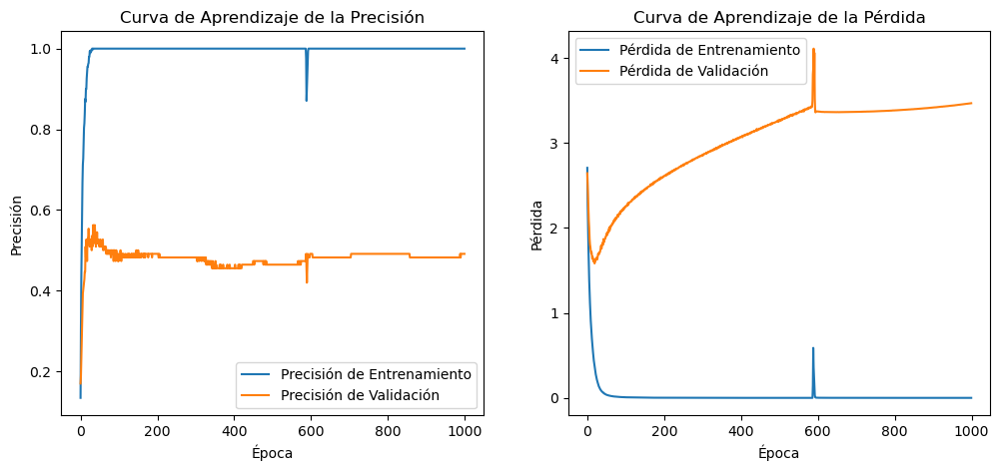

In [174]:
import matplotlib.pyplot as plt

# Suponiendo que 'history' es el objeto devuelto por 'model.fit()'

# Precisión
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Precisión de Entrenamiento')
plt.plot(history.history['val_accuracy'], label='Precisión de Validación')
plt.title('Curva de Aprendizaje de la Precisión')
plt.ylabel('Precisión')
plt.xlabel('Época')
plt.legend()

# Pérdida
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Pérdida de Entrenamiento')
plt.plot(history.history['val_loss'], label='Pérdida de Validación')
plt.title('Curva de Aprendizaje de la Pérdida')
plt.ylabel('Pérdida')
plt.xlabel('Época')
plt.legend()

plt.show()


# MODEL 2 RNN REGULARIZED

In [175]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import SimpleRNN, Dense, LSTM , Flatten , Dropout
from tensorflow.keras.regularizers import l1_l2

model = Sequential([
    SimpleRNN(64, input_shape=(X_train.shape[1], X_train.shape[2]), return_sequences=True),
    Flatten(),
    Dropout(0.5),  # Agregar Dropout
    Dense(64, activation='relu', kernel_regularizer=l1_l2(l1=1e-3, l2=1e-3)),  # Regularización L1/L2
    Dropout(0.5),  # Agregar otro Dropout
    Dense(y_train.shape[1], activation='softmax')
])

model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

In [176]:

# Entrenar el modelo
history = model.fit(X_train, y_train, epochs=1000, validation_data=(X_test, y_test))

Epoch 1/1000
14/14 [==============================] - 5s 194ms/step - loss: 5.0850 - accuracy: 0.0603 - val_loss: 4.5667 - val_accuracy: 0.0893
Epoch 2/1000
14/14 [==============================] - 0s 8ms/step - loss: 4.6304 - accuracy: 0.1027 - val_loss: 4.4882 - val_accuracy: 0.1518
Epoch 3/1000
14/14 [==============================] - 0s 8ms/step - loss: 4.4507 - accuracy: 0.1094 - val_loss: 4.4192 - val_accuracy: 0.1964
Epoch 4/1000
14/14 [==============================] - 0s 8ms/step - loss: 4.3580 - accuracy: 0.1451 - val_loss: 4.3289 - val_accuracy: 0.2143
Epoch 5/1000
14/14 [==============================] - 0s 6ms/step - loss: 4.2341 - accuracy: 0.1629 - val_loss: 4.2340 - val_accuracy: 0.2232
Epoch 6/1000
14/14 [==============================] - 0s 6ms/step - loss: 4.1210 - accuracy: 0.2321 - val_loss: 4.1205 - val_accuracy: 0.2500
Epoch 7/1000
14/14 [==============================] - 0s 9ms/step - loss: 3.9714 - accuracy: 0.2232 - val_loss: 4.0251 - val_accuracy: 0.2589
Epoc

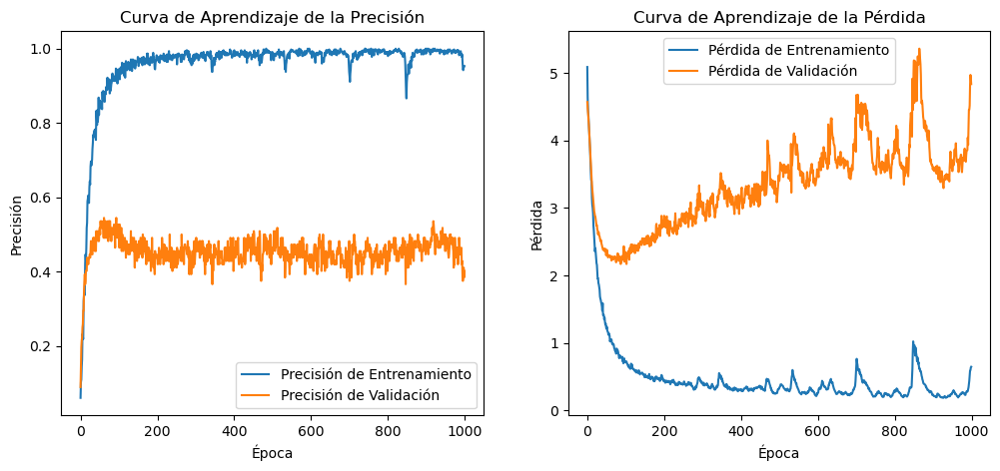

In [177]:
import matplotlib.pyplot as plt

# Suponiendo que 'history' es el objeto devuelto por 'model.fit()'

# Precisión
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Precisión de Entrenamiento')
plt.plot(history.history['val_accuracy'], label='Precisión de Validación')
plt.title('Curva de Aprendizaje de la Precisión')
plt.ylabel('Precisión')
plt.xlabel('Época')
plt.legend()



# Pérdida
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Pérdida de Entrenamiento')
plt.plot(history.history['val_loss'], label='Pérdida de Validación')
plt.title('Curva de Aprendizaje de la Pérdida')
plt.ylabel('Pérdida')
plt.xlabel('Época')
plt.legend()

plt.show()

# MODEL 2 LSTM

In [178]:
from tensorflow.keras.layers import Dropout
from tensorflow.keras.regularizers import l1_l2

model = Sequential([
    LSTM(32, input_shape=(X_train.shape[1], X_train.shape[2]),return_sequences=True),
    Flatten(),
    Dense(16, activation='relu'),
    Dense(y_train.shape[1], activation='softmax')
])


model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

In [179]:

# Entrenar el modelo
history = model.fit(X_train, y_train, epochs=1000, validation_data=(X_test, y_test))

Epoch 1/1000
14/14 [==============================] - 5s 81ms/step - loss: 2.6371 - accuracy: 0.0938 - val_loss: 2.6219 - val_accuracy: 0.0446
Epoch 2/1000
14/14 [==============================] - 0s 8ms/step - loss: 2.5755 - accuracy: 0.1228 - val_loss: 2.5840 - val_accuracy: 0.0804
Epoch 3/1000
14/14 [==============================] - 0s 8ms/step - loss: 2.5045 - accuracy: 0.1629 - val_loss: 2.5156 - val_accuracy: 0.1786
Epoch 4/1000
14/14 [==============================] - 0s 8ms/step - loss: 2.3947 - accuracy: 0.1987 - val_loss: 2.3911 - val_accuracy: 0.2054
Epoch 5/1000
14/14 [==============================] - 0s 8ms/step - loss: 2.2500 - accuracy: 0.2366 - val_loss: 2.2654 - val_accuracy: 0.1786
Epoch 6/1000
14/14 [==============================] - 0s 9ms/step - loss: 2.0988 - accuracy: 0.2589 - val_loss: 2.1626 - val_accuracy: 0.2143
Epoch 7/1000
14/14 [==============================] - 0s 8ms/step - loss: 1.9539 - accuracy: 0.3192 - val_loss: 2.0636 - val_accuracy: 0.2946
Epoch

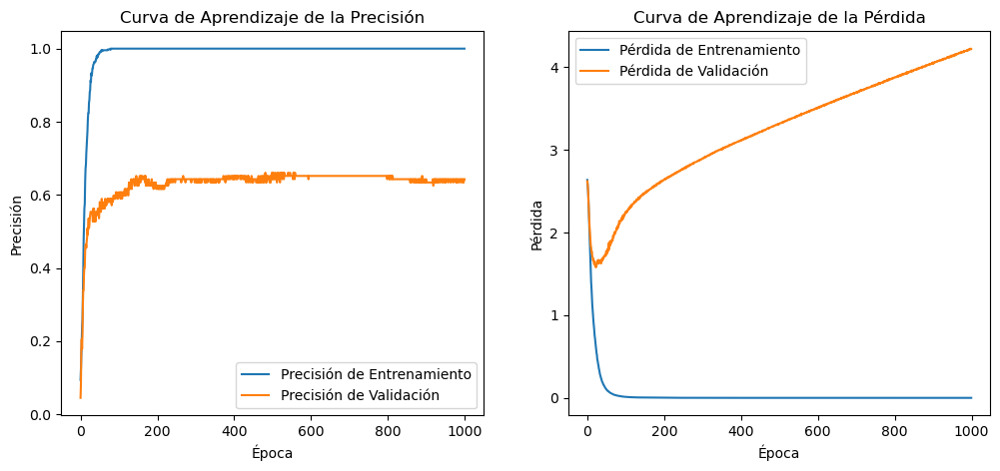

In [180]:
import matplotlib.pyplot as plt

# Suponiendo que 'history' es el objeto devuelto por 'model.fit()'

# Precisión
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Precisión de Entrenamiento')
plt.plot(history.history['val_accuracy'], label='Precisión de Validación')
plt.title('Curva de Aprendizaje de la Precisión')
plt.ylabel('Precisión')
plt.xlabel('Época')
plt.legend()

# Pérdida
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Pérdida de Entrenamiento')
plt.plot(history.history['val_loss'], label='Pérdida de Validación')
plt.title('Curva de Aprendizaje de la Pérdida')
plt.ylabel('Pérdida')
plt.xlabel('Época')
plt.legend()

plt.show()

# MODEL 3

Epoch 1/500
14/14 [==============================] - 8s 142ms/step - loss: 2.6175 - accuracy: 0.1406 - val_loss: 2.5281 - val_accuracy: 0.2768 - lr: 0.0100
Epoch 2/500
14/14 [==============================] - 0s 13ms/step - loss: 2.1671 - accuracy: 0.2656 - val_loss: 2.4311 - val_accuracy: 0.3036 - lr: 0.0100
Epoch 3/500
14/14 [==============================] - 0s 11ms/step - loss: 1.9016 - accuracy: 0.3594 - val_loss: 2.2980 - val_accuracy: 0.4018 - lr: 0.0100
Epoch 4/500
14/14 [==============================] - 0s 11ms/step - loss: 1.7504 - accuracy: 0.4040 - val_loss: 2.2466 - val_accuracy: 0.3750 - lr: 0.0100
Epoch 5/500
14/14 [==============================] - 0s 11ms/step - loss: 1.6682 - accuracy: 0.4062 - val_loss: 2.0261 - val_accuracy: 0.4554 - lr: 0.0100
Epoch 6/500
14/14 [==============================] - 0s 11ms/step - loss: 1.4721 - accuracy: 0.5000 - val_loss: 1.9889 - val_accuracy: 0.3929 - lr: 0.0100
Epoch 7/500
14/14 [==============================] - 0s 12ms/step - l

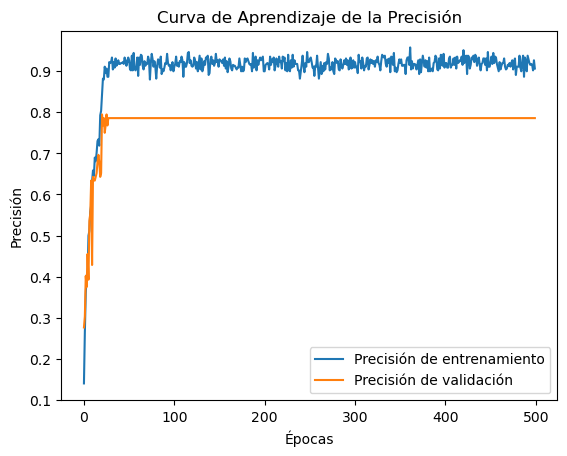

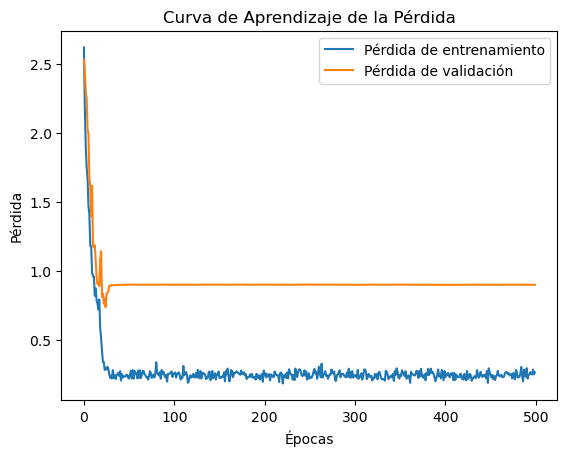

In [181]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout, BatchNormalization
from tensorflow.keras.regularizers import l1_l2
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.optimizers import RMSprop

# Definir el modelo
model = Sequential([
    LSTM(32, input_shape=(X_train.shape[1], X_train.shape[2]), return_sequences=True),
    LSTM(16, return_sequences=False),
    BatchNormalization(),
    Dropout(0.3),  # Reducir el dropout para evitar underfitting
    Dense(32, activation='relu', kernel_regularizer=l1_l2(l1=1e-6, l2=1e-5)),  # Regularización más suave
    Dropout(0.3),
    Dense(y_train.shape[1], activation='softmax')
])

# Compilar el modelo
optimizer = RMSprop(learning_rate=0.01)  # Cambiar a RMSprop con tasa de aprendizaje más baja
model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

# Callbacks para Early Stopping y Learning Rate Scheduler
early_stopping = EarlyStopping(monitor='val_loss', patience=1000, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=2, min_lr=1e-7, verbose=1)

# Entrenar el modelo
history = model.fit(
    X_train, y_train,
    epochs=500,
    validation_data=(X_test, y_test),
    callbacks=[early_stopping, reduce_lr],
    batch_size=32,  # Ajusta esto según la capacidad de tu GPU
    shuffle=True
)


# Tras entrenar, puedes graficar la curva de aprendizaje si deseas
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Precisión de entrenamiento')
plt.plot(history.history['val_accuracy'], label='Precisión de validación')
plt.title('Curva de Aprendizaje de la Precisión')
plt.xlabel('Épocas')
plt.ylabel('Precisión')
plt.legend()
plt.show()

plt.plot(history.history['loss'], label='Pérdida de entrenamiento')
plt.plot(history.history['val_loss'], label='Pérdida de validación')
plt.title('Curva de Aprendizaje de la Pérdida')
plt.xlabel('Épocas')
plt.ylabel('Pérdida')
plt.legend()
plt.show()


In [184]:

# Acceder a los registros de history para obtener el accuracy de entrenamiento y validación
train_acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

# Imprimir el accuracy del último epoch
print(f"Accuracy de entrenamiento sin reservoir en el último epoch: {train_acc[-1]*100:.2f}%")
print(f"Accuracy de validación sin reservoir en el último epoch: {val_acc[-1]*100:.2f}%")

Accuracy de entrenamiento sin reservoir en el último epoch: 90.62%
Accuracy de validación sin reservoir en el último epoch: 78.57%
